In [17]:
%load_ext autoreload
%autoreload 2

from trackformer.models.tracker import Tracker
from trackformer.models import build_model
from trackformer.models import detr_tracking
import torch

import matplotlib.pyplot as plt

from PIL import Image
import numpy as np


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [10]:
# !wget https://vision.in.tum.de/webshare/u/meinhard/trackformer_models_v1.zip
# !unzip trackformer_models_v1.zip

In [11]:
!cat mot20_crowdhuman_deformable_multi_frame/config.yaml  

aux_loss: true
backbone: resnet50
batch_size: 2
bbox_loss_coef: 5.0
clip_max_norm: 0.1
cls_loss_coef: 2.0
coco_and_crowdhuman_prev_frame_rnd_augs: 0.2
coco_panoptic_path: null
coco_path: data/coco_2017
crowdhuman_path: data/CrowdHuman
crowdhuman_train_split: train_val
dataset: mot_crowdhuman
debug: false
dec_layers: 6
dec_n_points: 4
deformable: true
device: cuda
dice_loss_coef: 1.0
dilation: false
dim_feedforward: 1024
dist_backend: nccl
dist_url: file:///storage/slurm/meinhard/runs/55907a2b2e8e46e183a2350973e6c240_init
distributed: true
dropout: 0.1
enc_layers: 6
enc_n_points: 4
eos_coef: 0.1
epochs: 60
eval_only: false
eval_train: false
focal_alpha: 0.25
focal_gamma: 2
focal_loss: true
freeze_detr: false
giou_loss_coef: 2
gpu: 2
hidden_dim: 288
img_transform: !!python/object:argparse.Namespace
  max_size: 1333
  val_width: 800
load_mask_head_from_model: null
lr: 0.0002
lr_backbone: 2.0e-05
lr_backbone_names:
- backbone.0
lr_drop: 10
lr_linear_proj_mult: 0.1
lr_linear_proj_names:
- r

In [12]:
!ls

Untitled.ipynb
combine_frames.py
compute_best_mean_epoch_from_splits.py
crowdhuman_deformable_multi_frame
detr-r50-panoptic-00ce5173.pth
generate_coco_from_crowdhuman.py
generate_coco_from_mot.py
madrid.png
modric.webp
mot17_crowdhuman_deformable_multi_frame
mot17_deformable_multi_frame
mot20_crowdhuman_deformable_multi_frame
mots20_train_masks
parse_mot_results_to_tex.py
r50_deformable_detr-checkpoint.pth
r50_deformable_detr_plus_iterative_bbox_refinement-checkpoint.pth
r50_deformable_detr_plus_iterative_bbox_refinement-checkpoint_hidden_dim_288.pth
run_with_submitit.py
sdfg.ipynb
track.py
track_param_search.py
trackformer
trackformer_models_v1.zip
trackformer_models_v1.zip.1
train.py


In [13]:
%autoreload 2

import os
import yaml
from trackformer.util.misc import nested_dict_to_namespace

obj_detect_checkpoint_file = 'mot20_crowdhuman_deformable_multi_frame/checkpoint_epoch_50.pth'
obj_detect_config_path = os.path.join(
        os.path.dirname(obj_detect_checkpoint_file),
        'config.yaml')
obj_detect_args = nested_dict_to_namespace(yaml.unsafe_load(open(obj_detect_config_path)))
img_transform = obj_detect_args.img_transform
obj_detect_args.device = 'cpu'
print(obj_detect_args.device)
obj_detector, _, obj_detector_post = build_model(obj_detect_args)
obj_detector.tracking()


obj_detect_checkpoint = torch.load(
            obj_detect_checkpoint_file, map_location=lambda storage, loc: storage)

obj_detect_state_dict = obj_detect_checkpoint['model']
obj_detect_state_dict = {
            k.replace('detr.', ''): v
            for k, v in obj_detect_state_dict.items()
            if 'track_encoding' not in k}
obj_detector.load_state_dict(obj_detect_state_dict)

tracker_cfg = yaml.unsafe_load(open('../cfgs/track.yaml'))['tracker_cfg']
tracker = Tracker(
    obj_detector,
    obj_detector_post,
    tracker_cfg,
    generate_attention_maps=False)

cpu
Making DeformableDETRTracking!!
Setting tracking=True training=False


In [14]:
obj_detector.training is tracker.obj_detector.training

True

In [15]:
tracker.obj_detector.training

False

In [89]:
%autoreload 2

w, h = (1920, 1080)
num_frames = 20
tracker.reset()

from tqdm.notebook import tqdm
from PIL import Image

image_sequence = []

dirname = '/Users/thomasdeegan/dev/trackformer/data/argentina/'
for i in tqdm(range(num_frames)):
    filename = "output_{:03d}.jpeg".format(i*4+1)
    image = Image.open(f'{dirname}jpegs/{filename}')
    arr = np.array(image, dtype=np.float32)[..., :3] / 255.0
    image_sequence.append(arr)
    
    with torch.no_grad():
    # Convert the NumPy array to a PyTorch tensor
        image_tensor = torch.from_numpy(arr)

        inputs = {
            'img':  image_tensor.unsqueeze(0).permute(0, 3, 1, 2),
            'orig_size': torch.tensor([[image.size[0], image.size[1]]])
        }
        tracker.step(inputs)

  0%|          | 0/20 [00:00<?, ?it/s]

self.frame_index: 0
None
self.frame_index: 1
num prev tracks: 9
[{'track_query_boxes': tensor([[7.7198e-04, 2.8982e-04, 2.2360e-05, 4.6663e-05],
        [6.0217e-04, 2.5237e-04, 2.4297e-05, 4.0424e-05],
        [3.5879e-05, 2.3791e-04, 1.7343e-05, 4.1987e-05],
        [6.4942e-04, 5.1317e-04, 3.2596e-05, 4.4232e-05],
        [8.8813e-04, 3.7151e-04, 2.5695e-05, 5.5461e-05],
        [3.6775e-04, 4.2444e-04, 2.8612e-05, 5.8843e-05],
        [5.3104e-04, 1.5664e-04, 1.2700e-05, 2.6603e-05],
        [5.7329e-04, 4.1937e-04, 3.1578e-05, 6.1018e-05],
        [4.5417e-04, 4.0784e-04, 2.9706e-05, 5.9139e-05]]), 'image_id': tensor([1]), 'track_query_hs_embeds': tensor([[ 1.0789, -0.2435, -0.8981,  ...,  0.2718,  0.0849,  0.0804],
        [ 1.2041, -0.4395, -0.4209,  ...,  0.6410,  0.2971, -0.0987],
        [ 1.2657, -0.1701, -0.8466,  ...,  0.4445,  0.3264,  0.3107],
        ...,
        [ 0.9180, -0.0415,  0.3727,  ...,  0.1088,  0.5902, -0.4214],
        [ 1.0331, -0.4049, -0.7665,  ...,  0.2

self.frame_index: 8
num prev tracks: 12
[{'track_query_boxes': tensor([[4.5993e-07, 9.2182e-08, 3.2086e-05, 5.8289e-05],
        [1.6564e-07, 9.1745e-08, 3.3034e-05, 6.3076e-05],
        [2.7982e-07, 4.1797e-08, 2.6540e-05, 4.3020e-05],
        [1.8839e-07, 1.1162e-07, 3.5919e-05, 6.9514e-05],
        [8.5298e-04, 3.6131e-04, 2.7168e-05, 5.2091e-05],
        [3.6109e-05, 2.3965e-04, 1.8277e-05, 4.1047e-05],
        [4.9230e-04, 1.6155e-04, 1.4271e-05, 2.6227e-05],
        [1.1720e-04, 3.1658e-04, 2.8636e-05, 4.3072e-05],
        [7.5335e-04, 2.8619e-04, 1.8772e-05, 4.4577e-05],
        [2.9114e-04, 3.6066e-04, 2.6192e-05, 5.0426e-05],
        [5.6674e-04, 4.0967e-04, 2.5394e-05, 5.7316e-05],
        [4.4151e-04, 3.9904e-04, 2.8155e-05, 5.5473e-05]]), 'image_id': tensor([1]), 'track_query_hs_embeds': tensor([[ 0.1530,  0.7873, -0.5823,  ...,  0.8623,  0.1995,  0.3478],
        [ 0.1369,  0.8086, -0.6160,  ...,  0.8890,  0.2257,  0.3323],
        [ 0.1530,  0.7810, -0.5903,  ...,  0.9081

self.frame_index: 14
num prev tracks: 13
[{'track_query_boxes': tensor([[8.6975e-09, 5.1009e-09, 3.4144e-05, 5.6640e-05],
        [2.3158e-07, 9.5298e-08, 3.4331e-05, 6.2674e-05],
        [2.0901e-07, 8.2816e-08, 3.1044e-05, 5.4635e-05],
        [3.2274e-07, 9.4213e-08, 3.2103e-05, 5.9804e-05],
        [3.2949e-07, 5.6718e-08, 2.7104e-05, 4.5345e-05],
        [4.3322e-04, 3.9460e-04, 3.4739e-05, 5.5105e-05],
        [8.4776e-04, 2.2575e-04, 1.8390e-05, 3.9220e-05],
        [3.8318e-04, 3.7916e-04, 3.4824e-05, 5.1227e-05],
        [2.9982e-04, 3.5143e-04, 2.7720e-05, 4.6703e-05],
        [2.8901e-05, 2.4026e-04, 1.6859e-05, 3.9778e-05],
        [8.3306e-04, 3.5476e-04, 2.3046e-05, 5.0082e-05],
        [5.6414e-04, 4.0301e-04, 2.5955e-05, 5.6056e-05],
        [5.0983e-04, 2.4673e-04, 1.8596e-05, 3.6343e-05]]), 'image_id': tensor([1]), 'track_query_hs_embeds': tensor([[ 0.1694,  0.7796, -0.4400,  ...,  0.8365,  0.1793,  0.2281],
        [ 0.1637,  0.8616, -0.5403,  ...,  0.9085,  0.2416, 

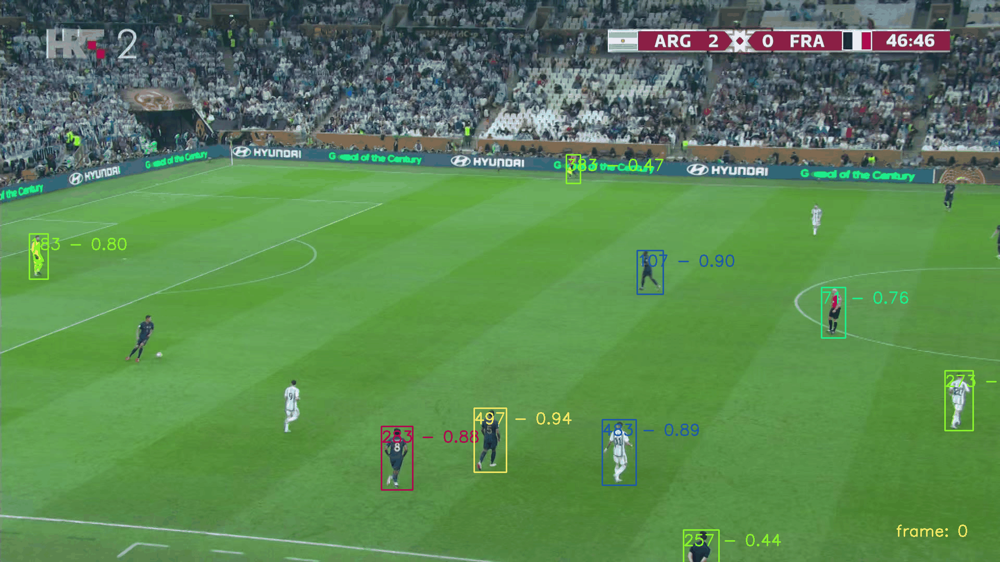

In [88]:
import cv2
from IPython.display import Image, display

frame_limit = 20
# Set the figure size
# fig = plt.figure(figsize=(30*frame_limit, 40))

# # Create a subplot grid
# grid = plt.GridSpec(frame_limit, 1)

import random
import colorsys

def generate_colors(n):
    colors = []
    for i in range(n):
        hue = i / n
        lightness = 0.5 # we keep lightness and saturation constant
        saturation = 1.0
        r, g, b = [x for x in colorsys.hls_to_rgb(hue, lightness, saturation)]
        colors.append((r, g, b)) # The colors are represented as RGB tuples

    random.shuffle(colors)
    return colors


colors = generate_colors(1000)

font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
color = (0, 0, 0)
line_type = 2

images = []
for i in range(frame_limit):
    # Plot each image in a separate subplot
    image_array = image_sequence[i]
    image_array = cv2.cvtColor(image_array, cv2.COLOR_RGB2BGR)

    h, w, _ = image_array.shape
    for track_id, track in tracker.get_results().items():
        
        if i in track:
            bbox = track[i]['bbox']
            obj_id = track[i]['obj_ind']
            score = float(track[i]['score'])
            x = (int(bbox[0] * w), int(bbox[1] * h))
            y = (int(bbox[2] * w), int(bbox[3] * h))
            color = colors[obj_id]
            cv2.rectangle(image_array, x, y, color, 2)
            cv2.putText(image_array, f'{obj_id} - {score:.2f}', (x[0], x[1] + 30), font, font_scale, color, line_type)
    
    position = (w - 200, h - 50)
    
    cv2.putText(image_array, f'frame: {i}', position, font, font_scale, color, line_type)
    image_array = cv2.cvtColor(image_array, cv2.COLOR_RGB2BGR)
    images.append((image_array * 255).astype('uint8'))

imageio.mimsave(f'{dirname}/animated.gif', images, loop=0)

# Display the GIF in Jupyter Notebook
with open(f'{dirname}animated.gif','rb') as f:
    display(Image(data=f.read(), format='png'))

In [81]:
tracker.get_results()

{0: {0: {'bbox': array([0.8216604 , 0.51166654, 0.845809  , 0.6012598 ], dtype=float32),
   'score': array(0.7573069, dtype=float32),
   'obj_ind': 71}},
 1: {0: {'bbox': array([0.6372225 , 0.44574794, 0.66346323, 0.52336156], dtype=float32),
   'score': array(0.90098625, dtype=float32),
   'obj_ind': 107},
  1: {'bbox': array([-0.01709182, -0.052849  ,  0.01750349,  0.05315495], dtype=float32),
   'score': array(0.85888696, dtype=float32),
   'obj_ind': 107}},
 2: {0: {'bbox': array([0.02938365, 0.41647798, 0.04811456, 0.49709284], dtype=float32),
   'score': array(0.7958771, dtype=float32),
   'obj_ind': 183}},
 3: {0: {'bbox': array([0.68377197, 0.94282186, 0.7189752 , 1.0277474 ], dtype=float32),
   'score': array(0.44248134, dtype=float32),
   'obj_ind': 257}},
 4: {0: {'bbox': array([0.9453084 , 0.66006607, 0.9730585 , 0.76655096], dtype=float32),
   'score': array(0.58140475, dtype=float32),
   'obj_ind': 273}},
 5: {0: {'bbox': array([0.38171938, 0.75843   , 0.41262087, 0.87140

In [67]:
%matplotlib inline

# Open the PNG image using PIL
# image = Image.open('modric.webp')
image = Image.open('madrid.png')

image = image.resize((1920, 1080))

# Convert the image to a NumPy array
image_array = np.array(image, dtype=np.float32)[..., :3]
image_array /= 255.0

plt.imshow(image_array)

AttributeError: type object 'Image' has no attribute 'open'

In [ ]:
from trackformer.models import detr_tracking
import torch

with torch.no_grad():
# Convert the NumPy array to a PyTorch tensor
    image_tensor = torch.from_numpy(image_array)

    
    tracker.reset()
    inputs = {
        'img':  image_tensor.unsqueeze(0).permute(0, 3, 1, 2),
        'orig_size': torch.tensor([[image.size[0], image.size[1]]])
    }
    outputs = tracker.step(inputs)

In [ ]:
import cv2

w, h = (1920, 1080)
image = Image.open('madrid.png')
image = image.resize((w,h))
print(image.size)

image_array = np.array(image, dtype=np.float32)[..., :3]

image_array = cv2.cvtColor(image_array, cv2.COLOR_RGB2BGR)

results = tracker.get_results()
for i in range(len(results)):
    track = results[i]
    bbox = track[0]['bbox']
    image_array = cv2.rectangle(image_array, (int(bbox[0] * w), int(bbox[1] * h)), (int(bbox[2] * w), int(bbox[3] * h)), (50, 50, 250), 1)

image_array = cv2.cvtColor(image_array, cv2.COLOR_RGB2BGR)
plt.imshow(image_array / 255)

In [ ]:
tracker.get_results()

In [ ]:
tracker.reset()
tracker.get_results()

In [ ]:
a= tracker.debug_outputs['features'][2]
a, _ = torch.max(a.tensors, dim=1)
plt.imshow(a[0].numpy())

In [ ]:
tracker.get_results()

In [ ]:
img_idx = 0
image_array = cv2.cvtColor(image_sequence[img_idx], cv2.COLOR_RGB2BGR)

results = tracker.get_results()
for i in range(len(results)):
    if i not in results:
        continue
    track = results[i]
    if not img_idx in track:
        continue
    bbox = track[0]['bbox']
    image_array = cv2.rectangle(image_array, (int(bbox[0] * w), int(bbox[1] * h)), (int(bbox[2] * w), int(bbox[3] * h)), (50, 50, 250), 1)

image_array = cv2.cvtColor(image_array, cv2.COLOR_RGB2BGR)

plt.imshow(image_array)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Generate some sample images
image1 = np.random.random((10, 10))
image2 = np.random.random((10, 10))
image3 = np.random.random((10, 10))

# Set the figure size
fig = plt.figure(figsize=(12, 4))

# Create a subplot grid
grid = plt.GridSpec(4,1)

for i, feat in enumerate(tracker.debug_outputs['features']):

    # Plot each image in a separate subplot
    ax1 = plt.subplot(grid[i,0])
    img, _ = torch.max(tracker.debug_outputs['features'][i].unmasked_tensor(0), dim=0)
    ax1.imshow(img)
    ax1.set_title(f'Features {i}')
    ax1.axis('off')


# Adjust spacing between subplots
plt.tight_layout()
plt.show()

In [ ]:
tracker.debug_outputs

In [ ]:
tracker.debug_outputs['features'][0]

In [ ]:
tracker.debug_outputs['outputs'].keys()

In [ ]:
tracker.debug_outputs['obj_detector_post']['scores']

In [ ]:
tracker.detection_obj_score_thresh

In [ ]:
tracker.debug_outputs['obj_detector_post']['labels']

In [ ]:
# torch.argmax(tracker.debug_outputs['outputs']['pred_logits'], dim=-1)
tracker.debug_outputs['outputs']['pred_logits'].sigmoid()

In [ ]:
tracker.get_results()

In [ ]:
from IPython.display import Image, display
display(Image(filename='madrid.png'))

In [ ]:
import torchvision
torchvision.ops.misc.interpolate

In [ ]:
import ssl
ssl

In [ ]:
ssl.OPENSSL_VERSION